# import libraries

In [27]:
import numpy as np
import sklearn.metrics as metrics
import matplotlib.pyplot as plt
import os
import cv2
from sklearn.model_selection import train_test_split
import math 
from pathlib import Path

from tensorflow.keras.callbacks import ModelCheckpoint,CSVLogger
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Dense, Flatten, Reshape
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Concatenate
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.models import Model 

In [2]:
plt.style.use('ggplot')
plt.rcParams['ytick.right'] = True
plt.rcParams['ytick.labelright']= True
plt.rcParams['ytick.left']      = False
plt.rcParams['ytick.labelleft'] = False
plt.rcParams['font.family']     = 'Arial'

# Data preparation

In [3]:
def display2(array1, array2):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices, :]
    images2 = array2[indices, :]

    plt.figure(figsize=(20, 4))
    for i, (image1, image2) in enumerate(zip(images1, images2)):
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(image1)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(image2)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()
    
def display3(array1, array2, array3):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices, :]
    images2 = array2[indices, :]
    images3 = array3[indices, :]

    plt.figure(figsize=(20, 6))
    for i, (image1, image2, image3) in enumerate(zip(images1, images2, images3)):
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(image1)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(image2)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        
        ax = plt.subplot(3, n, i + 1 + n*2)
        plt.imshow(image3)
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()
    
def display1(array1):
    """
    Displays ten random images from each one of the supplied arrays.
    """

    n = 10

    indices = np.random.randint(len(array1), size=n)
    images1 = array1[indices]


    plt.figure(figsize=(20, 4))
    for i, image1 in enumerate(images1):
        ax = plt.subplot(1, n, i + 1)
        plt.imshow(image1)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


    plt.show()

In [29]:
# params
IMAGE_SIZE = (128, 128)
# ENCODER_DIM = 1024

def getImageData(fn_list, file_path):
    all_imgs = []
    for fn in fn_list:
        img = cv2.imread(file_path + fn)
        img_flip_along_y = cv2.flip(img, 1)
        
        img = cv2.resize(img, IMAGE_SIZE).astype('float32') / 255.0
        img_flip_along_y = cv2.resize(img_flip_along_y, IMAGE_SIZE).astype('float32') / 255.0
        
        all_imgs += [np.expand_dims(img, 0)]
        all_imgs += [np.expand_dims(img_flip_along_y, 0)]
    return np.vstack(all_imgs)

def getFnList(path):
    files = os.listdir(path)
    return files

(1077, 128, 128, 3)


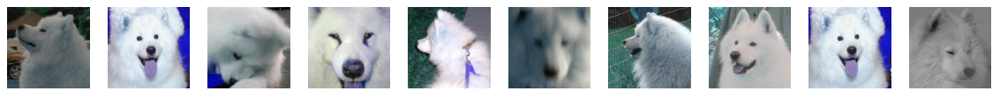

(935, 128, 128, 3)


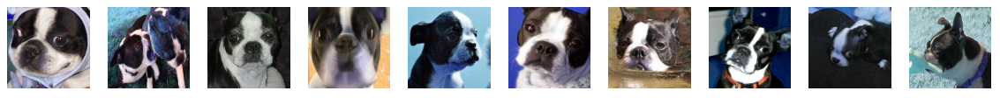

In [30]:
# tiger
# file_path_A = '../input/subanimalfaces/n02129604/n02129604/'
# fox dog
# file_path_A = '../input/subanimalfaces/n02111889/n02111889/'
file_path_A = '../input/subanimalfaces/n02111889/n02111889/'
# er ha
# file_path_B = '../input/subanimalfaces/n02110063/n02110063/'
# fa dou
file_path_B = '../input/fadoudog/n02096585/'

data_A = getImageData(getFnList(file_path_A), file_path_A)
train_data_A, test_data_A = train_test_split(data_A, test_size=0.33)
print(train_data_A.shape)
display1(train_data_A)

data_B = getImageData(getFnList(file_path_B), file_path_B)
train_data_B, test_data_B = train_test_split(data_B, test_size=0.33)
print(train_data_B.shape)
display1(train_data_B)

# build model

In [6]:
!pip install git+https://www.github.com/keras-team/keras-contrib.git

  Cloning https://www.github.com/keras-team/keras-contrib.git to /tmp/pip-req-build-8z0br9gv
  Running command git clone -q https://www.github.com/keras-team/keras-contrib.git /tmp/pip-req-build-8z0br9gv
  Resolved https://www.github.com/keras-team/keras-contrib.git to commit 3fc5ef709e061416f4bc8a92ca3750c824b5d2b0
  Created wheel for keras-contrib: filename=keras_contrib-2.0.8-py3-none-any.whl size=101077 sha256=c65e4c07e617468e0c8ee59693885eaa4eedfc5dee881071ace7646bf10c18ef
  Stored in directory: /tmp/pip-ephem-wheel-cache-6ef87h78/wheels/bb/1f/f2/b57495012683b6b20bbae94a3915ec79753111452d79886abc
Successfully built keras-contrib


In [31]:
# example of defining a 70x70 patchgan discriminator model
from tensorflow.keras.initializers import RandomNormal
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization

# define the discriminator model
def define_discriminator(image_shape):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# source image input
	in_image = Input(shape=image_shape)
	# C64
	d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(in_image)
	d = LeakyReLU(alpha=0.2)(d)
	# C128
	d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C256
	d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C512
	d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# second last output layer
	d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization(axis=-1)(d)
	d = LeakyReLU(alpha=0.2)(d)
	# patch output
	patch_out = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
	# define model
	model = Model(in_image, patch_out)
	# compile model
	model.compile(loss='mse', optimizer=Adam(lr=0.0002, beta_1=0.5), loss_weights=[0.5])
	return model

In [32]:
# generator a resnet block
def resnet_block(n_filters, input_layer):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# first layer convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(input_layer)
	g = InstanceNormalization(axis=-1)(g)
	g = Activation('relu')(g)
	# second convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(g)
	g = InstanceNormalization(axis=-1)(g)
	# concatenate merge channel-wise with input layer
	g = Concatenate()([g, input_layer])
	return g

In [58]:
class MyModel():
    def __init__(self):
        self.g_A2B = self.define_generator()
        self.g_B2A = self.define_generator()
        
    def define_generator(self, image_shape=(128,128,3), n_resnet=2):
        # weight initialization
        init = RandomNormal(stddev=0.02)
        # image input
        in_image = Input(shape=image_shape)
        # c7s1-64
        g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # d128
        g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # d256
        g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # R256
        for _ in range(n_resnet):
            g = resnet_block(256, g)
        # u128
        g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # u64
        g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        g = Activation('relu')(g)
        # c7s1-3
        g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
        g = InstanceNormalization(axis=-1)(g)
        out_image = Activation('tanh')(g)
        # define model
        model = Model(in_image, out_image)
        return model
        
        
    def load_weights(self):
        try:
            self.g_A2B.load_weights(model_dir + g_A2BH5)
            self.g_B2A.load_weights(model_dir + g_B2AH5)
            d_A.load_weights(model_dir + d_AH5)
            d_B.load_weights(model_dir + d_BH5)
            print('loaded model weights')
            return True
        except Exception as e:
            print('Failed loading existing training data.')
            print(e)
            return False

    def save_weights(self):
        self.g_A2B.save_weights(model_dir + g_A2BH5)
        self.g_B2A.save_weights(model_dir + g_B2AH5)
        print('saved generator weights')
        d_A.save_weights(model_dir + d_AH5)
        d_B.save_weights(model_dir + d_BH5)
        print('saved discriminator weights')

In [59]:
my_model = MyModel()
my_model.g_A2B.summary()

Model: "model_36"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_46 (InputLayer)           [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d_357 (Conv2D)             (None, 128, 128, 64) 9472        input_46[0][0]                   
__________________________________________________________________________________________________
instance_normalization_379 (Ins (None, 128, 128, 64) 128         conv2d_357[0][0]                 
__________________________________________________________________________________________________
activation_234 (Activation)     (None, 128, 128, 64) 0           instance_normalization_379[0][0] 
___________________________________________________________________________________________

In [60]:
my_model = MyModel()
g_A2B = my_model.g_A2B
g_B2A = my_model.g_B2A
# input shape
image_shape = (128,128,3)
# discriminator: A -> [real/fake]
d_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_B = define_discriminator(image_shape)

In [49]:
# define a composite model for updating generators by adversarial and cycle loss
def define_composite_model(g_model_1, d_model, g_model_2, image_shape):
	# ensure the model we're updating is trainable
	g_model_1.trainable = True
	# mark discriminator as not trainable
	d_model.trainable = False
	# mark other generator model as not trainable
	g_model_2.trainable = False
	# discriminator element
	input_gen = Input(shape=image_shape)
	gen1_out = g_model_1(input_gen)
	output_d = d_model(gen1_out)
	# identity element
	input_id = Input(shape=image_shape)
	output_id = g_model_1(input_id)
	# forward cycle
	output_f = g_model_2(gen1_out)
	# backward cycle
	gen2_out = g_model_2(input_id)
	output_b = g_model_1(gen2_out)
	# define model graph
	model = Model([input_gen, input_id], [output_d, output_id, output_f, output_b])
	# define optimization algorithm configuration
	opt = Adam(lr=0.0002, beta_1=0.5)
	# compile model with weighting of least squares loss and L1 loss
    # adversial loss, identity loss, forward loss, backward loss
	model.compile(loss=['mse', 'mae', 'mae', 'mae'], loss_weights=[5, 1, 10, 10], optimizer=opt)
	return model

In [61]:
# composite: A -> B -> [real/fake, A]
c_model_AtoB = define_composite_model(g_A2B, d_B, g_B2A, image_shape)
# composite: B -> A -> [real/fake, B]
c_model_BtoA = define_composite_model(g_B2A, d_A, g_A2B, image_shape)

# train model

In [62]:
g_A2BH5 = 'g_A2B.h5'
g_B2AH5 = 'g_B2A.h5'
d_AH5 = 'd_A.h5'
d_BH5 = 'd_B.h5'
model_dir = './my_model_fadou_foxDog/'

In [63]:
# !rm -rf ./my_model_fadou_foxDog

In [65]:
!zip -r ddd7.zip ./my_model_fadou_foxDog

  adding: my_model_fadou_foxDog/ (stored 0%)
  adding: my_model_fadou_foxDog/g_A2B.h5 (deflated 8%)
  adding: my_model_fadou_foxDog/g_B2A.h5 (deflated 8%)
  adding: my_model_fadou_foxDog/d_A.h5 (deflated 7%)
  adding: my_model_fadou_foxDog/d_B.h5 (deflated 7%)


In [43]:
from random import sample
# select a batch of random samples, returns images and target
def generate_real_samples(dataset, n_samples, patch_shape):
    # choose random instances
#     ix = sample(range(0, dataset.shape[0]-1), n_samples)
    # retrieve selected images
#     X = dataset[ix]
    X = dataset
    n = len(X)
    # generate 'real' class labels (1)
    y = np.ones((n, patch_shape, patch_shape, 1))
    return X, y

In [20]:
# generate a batch of images, returns images and targets
def generate_fake_samples(g_model, dataset, patch_shape):
	# generate fake instance
	X = g_model.predict(dataset)
	# create 'fake' class labels (0)
	y = np.zeros((len(X), patch_shape, patch_shape, 1))
	return X, y

In [24]:
from random import randint
from random import random
# update image pool for fake images
def update_image_pool(pool, images, max_size=50):
	selected = list()
	for image in images:
		if len(pool) < max_size:
			# stock the pool
			pool.append(image)
			selected.append(image)
		elif random() < 0.5:
			# use image, but don't add it to the pool
			selected.append(image)
		else:
			# replace an existing image and use replaced image
			ix = randint(0, len(pool)-1)
			selected.append(pool[ix])
			pool[ix] = image
	return np.asarray(selected)

Failed loading existing training data.
Unable to open file (unable to open file: name = './my_model_fadou_foxDog/g_A2B.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)
==== epoch 0
discriminator loss: B_on_real: 0.1394, B_on_fake: 0.1799, A_on_real: 0.2418, A_on_fake: 0.1753
generator A2B loss: total: 13.0497, adversarial: 0.9395, identity: 0.4212, forward: 0.4488, backward: 0.3443
generator B2A loss: total: 13.9651, adversarial: 1.1026, identity: 0.5498, forward: 0.3417, backward: 0.4485
============= train set ================
====== A as input


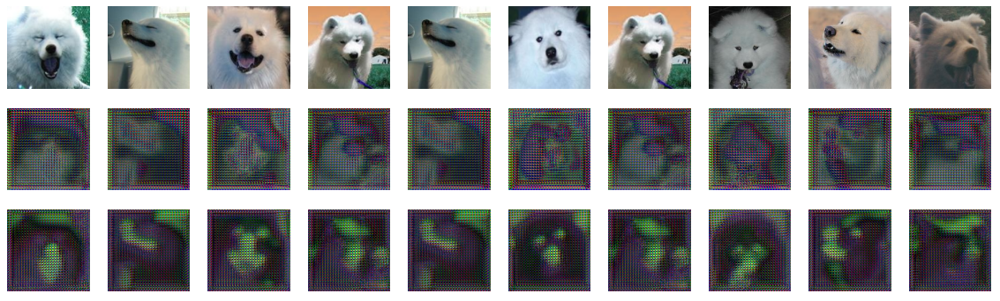

====== B as input


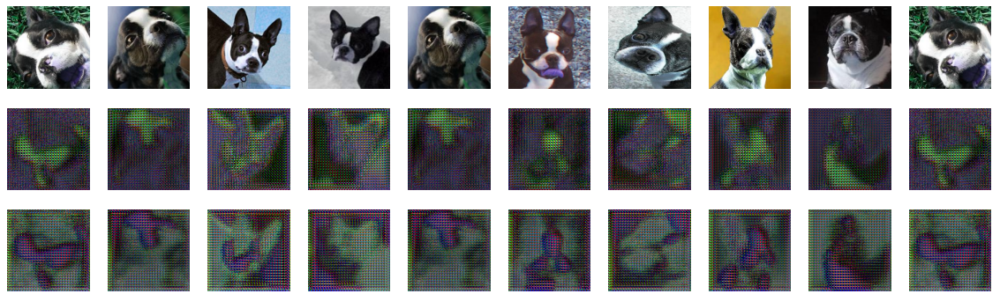

============= test set ================
====== A as input


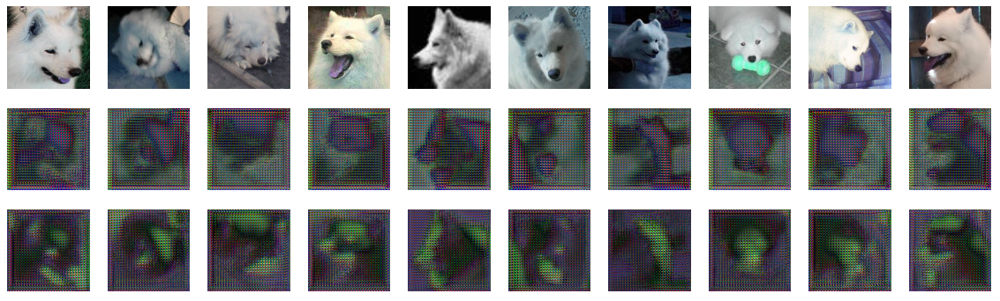

====== B as input


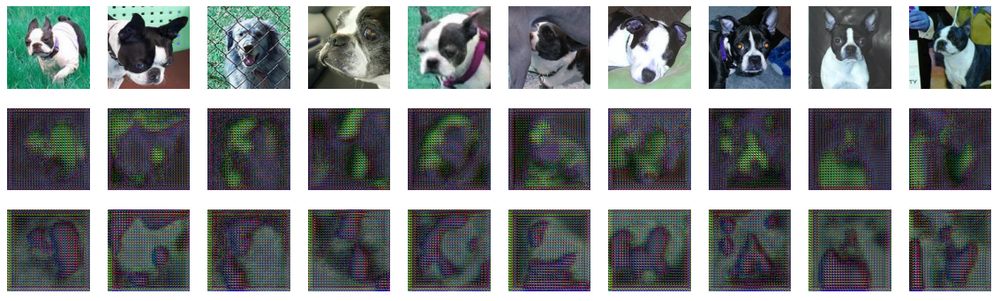

saved generator weights
saved discriminator weights
==== epoch 1
discriminator loss: B_on_real: 0.0780, B_on_fake: 0.1104, A_on_real: 0.0782, A_on_fake: 0.1067
generator A2B loss: total: 11.3849, adversarial: 0.7006, identity: 0.4546, forward: 0.4164, backward: 0.3263
generator B2A loss: total: 12.5805, adversarial: 0.9170, identity: 0.6147, forward: 0.3235, backward: 0.4146
==== epoch 2
discriminator loss: B_on_real: 0.0449, B_on_fake: 0.0665, A_on_real: 0.0469, A_on_fake: 0.0360
generator A2B loss: total: 10.5423, adversarial: 0.5938, identity: 0.4720, forward: 0.4026, backward: 0.3075
generator B2A loss: total: 13.5404, adversarial: 1.1908, identity: 0.5220, forward: 0.3048, backward: 0.4016
==== epoch 3
discriminator loss: B_on_real: 0.0330, B_on_fake: 0.0506, A_on_real: 0.0904, A_on_fake: 0.0459
generator A2B loss: total: 11.1233, adversarial: 0.8112, identity: 0.4394, forward: 0.3761, backward: 0.2867
generator B2A loss: total: 9.9728, adversarial: 0.5676, identity: 0.5292, forwa

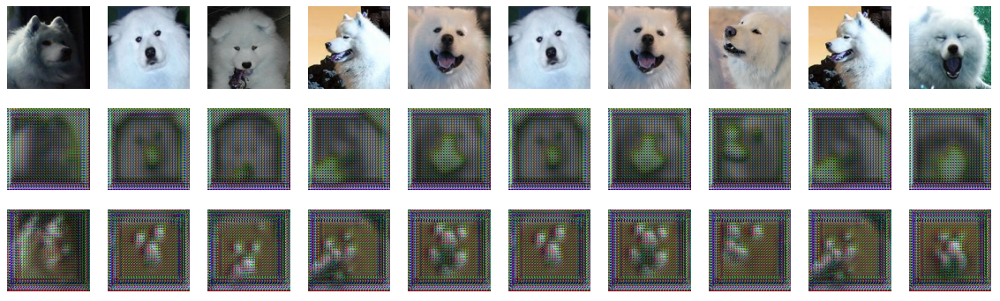

====== B as input


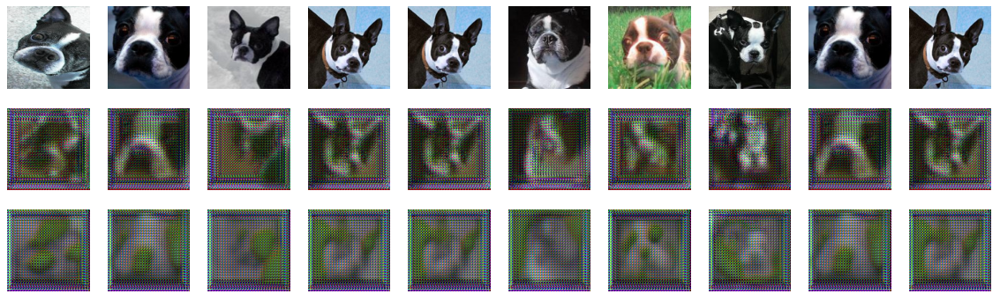

============= test set ================
====== A as input


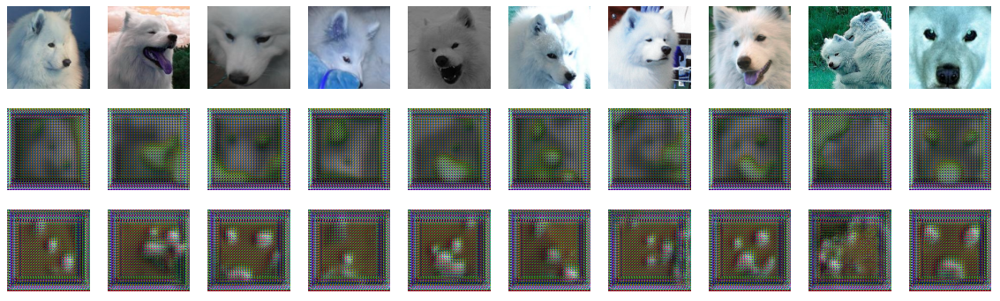

====== B as input


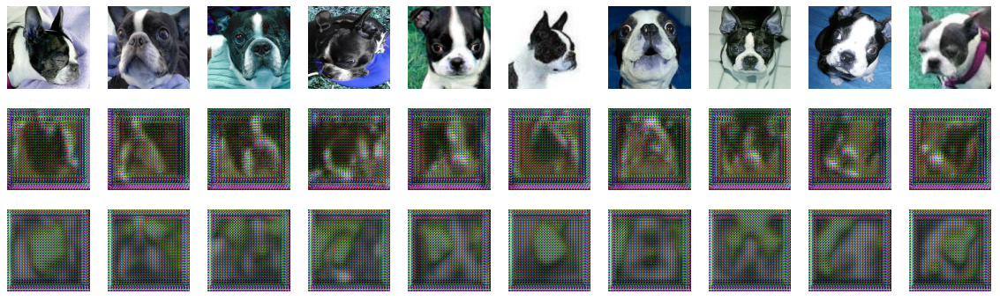

saved generator weights
saved discriminator weights
==== epoch 11
discriminator loss: B_on_real: 0.0077, B_on_fake: 0.0166, A_on_real: 0.0093, A_on_fake: 0.0089
generator A2B loss: total: 10.2160, adversarial: 0.8899, identity: 0.5225, forward: 0.2964, backward: 0.2280
generator B2A loss: total: 9.3995, adversarial: 0.7307, identity: 0.5081, forward: 0.2262, backward: 0.2976
==== epoch 12
discriminator loss: B_on_real: 0.0105, B_on_fake: 0.0094, A_on_real: 0.0021, A_on_fake: 0.0025
generator A2B loss: total: 10.3421, adversarial: 0.9768, identity: 0.3181, forward: 0.2925, backward: 0.2215
generator B2A loss: total: 10.4563, adversarial: 0.9680, identity: 0.5102, forward: 0.2190, backward: 0.2916
==== epoch 13
discriminator loss: B_on_real: 0.0343, B_on_fake: 0.0378, A_on_real: 0.0106, A_on_fake: 0.0078
generator A2B loss: total: 10.9854, adversarial: 1.0917, identity: 0.5456, forward: 0.2823, backward: 0.2158
generator B2A loss: total: 10.7252, adversarial: 1.0505, identity: 0.5106, fo

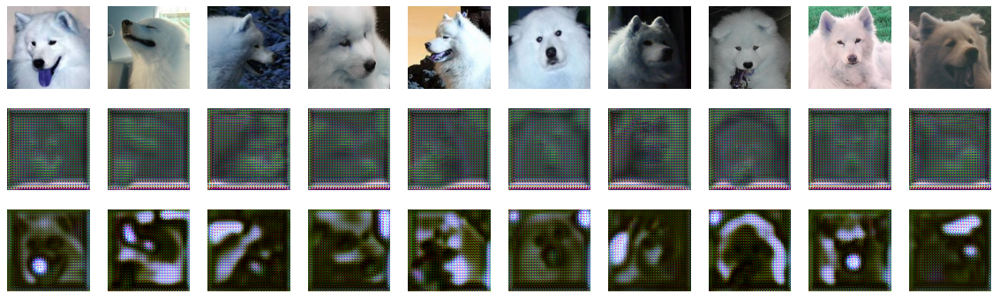

====== B as input


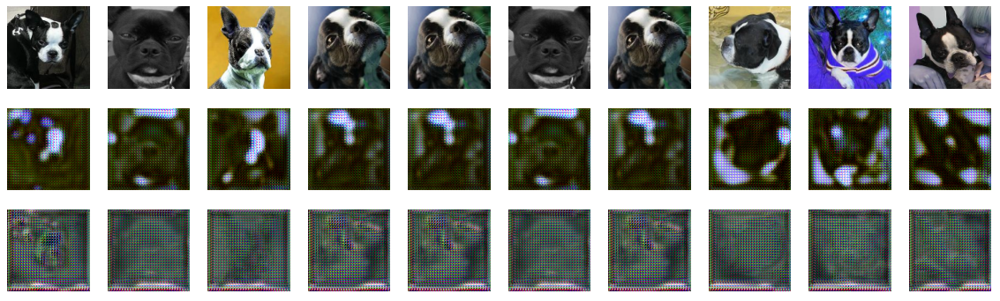

============= test set ================
====== A as input


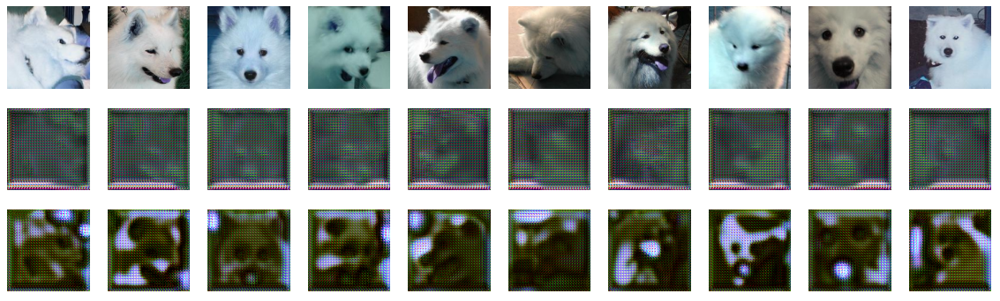

====== B as input


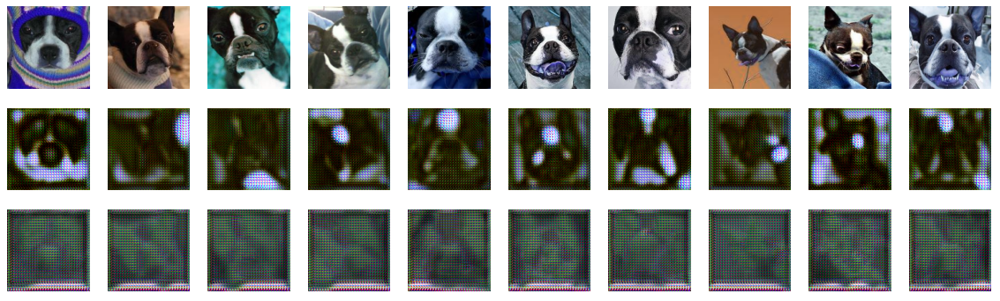

saved generator weights
saved discriminator weights
==== epoch 21
discriminator loss: B_on_real: 0.0278, B_on_fake: 0.0244, A_on_real: 0.0040, A_on_fake: 0.0040
generator A2B loss: total: 10.2108, adversarial: 1.0072, identity: 0.4169, forward: 0.2793, backward: 0.1965
generator B2A loss: total: 9.8720, adversarial: 0.9699, identity: 0.3538, forward: 0.1963, backward: 0.2705
==== epoch 22
discriminator loss: B_on_real: 0.0695, B_on_fake: 0.0886, A_on_real: 0.0016, A_on_fake: 0.0036
generator A2B loss: total: 10.3165, adversarial: 1.0397, identity: 0.3171, forward: 0.2530, backward: 0.2271
generator B2A loss: total: 9.7709, adversarial: 0.9176, identity: 0.5319, forward: 0.2152, backward: 0.2499
==== epoch 23
discriminator loss: B_on_real: 0.0223, B_on_fake: 0.0098, A_on_real: 0.0009, A_on_fake: 0.0008
generator A2B loss: total: 9.5205, adversarial: 0.9952, identity: 0.2911, forward: 0.2428, backward: 0.1826
generator B2A loss: total: 9.4124, adversarial: 0.9460, identity: 0.4882, forwa

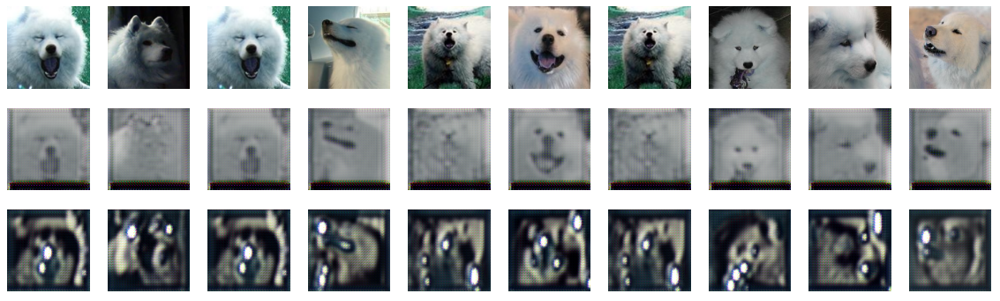

====== B as input


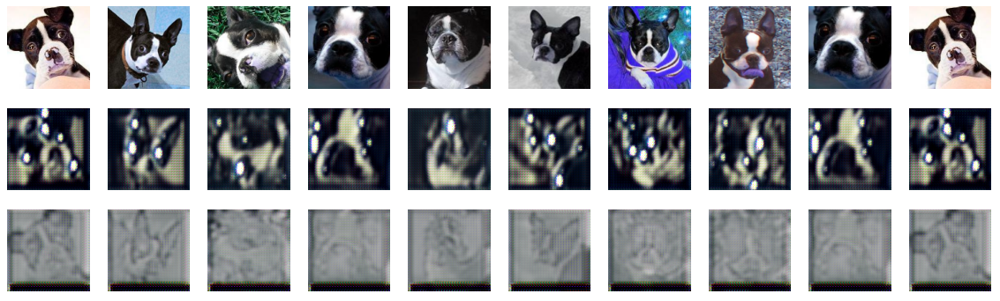

============= test set ================
====== A as input


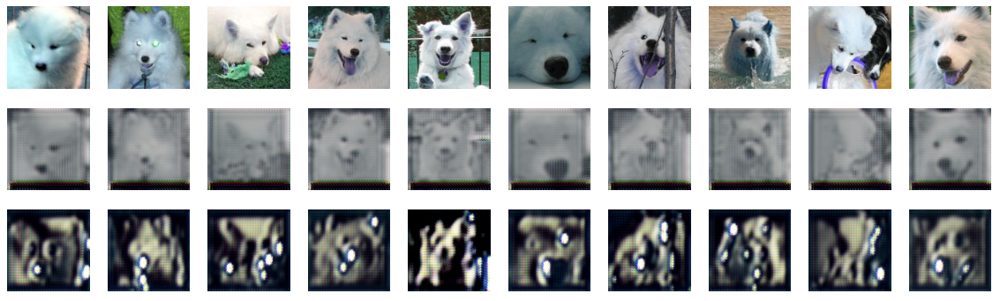

====== B as input


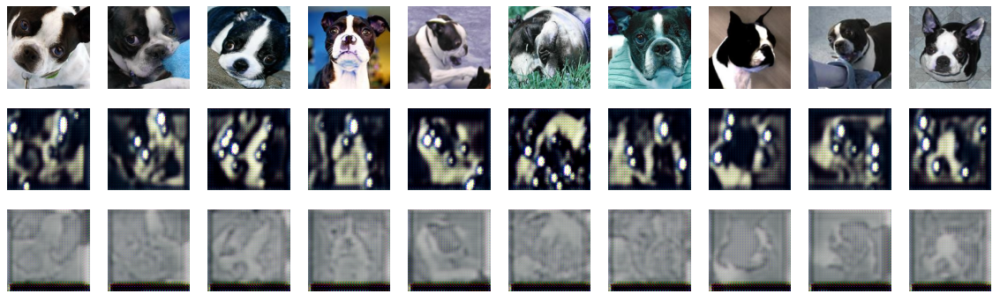

saved generator weights
saved discriminator weights
==== epoch 31
discriminator loss: B_on_real: 0.1885, B_on_fake: 0.0982, A_on_real: 0.0007, A_on_fake: 0.0012
generator A2B loss: total: 10.0451, adversarial: 1.1459, identity: 0.3408, forward: 0.2291, backward: 0.1684
generator B2A loss: total: 9.3536, adversarial: 1.0104, identity: 0.2820, forward: 0.1708, backward: 0.2311
==== epoch 32
discriminator loss: B_on_real: 0.2922, B_on_fake: 0.0357, A_on_real: 0.0041, A_on_fake: 0.0028
generator A2B loss: total: 13.1327, adversarial: 1.7435, identity: 0.3285, forward: 0.2422, backward: 0.1665
generator B2A loss: total: 9.4456, adversarial: 1.0206, identity: 0.2782, forward: 0.1678, backward: 0.2386
==== epoch 33
discriminator loss: B_on_real: 0.1352, B_on_fake: 0.0486, A_on_real: 0.0009, A_on_fake: 0.0004
generator A2B loss: total: 8.8253, adversarial: 0.9358, identity: 0.3548, forward: 0.2238, backward: 0.1554
generator B2A loss: total: 9.3207, adversarial: 1.0432, identity: 0.2953, forwa

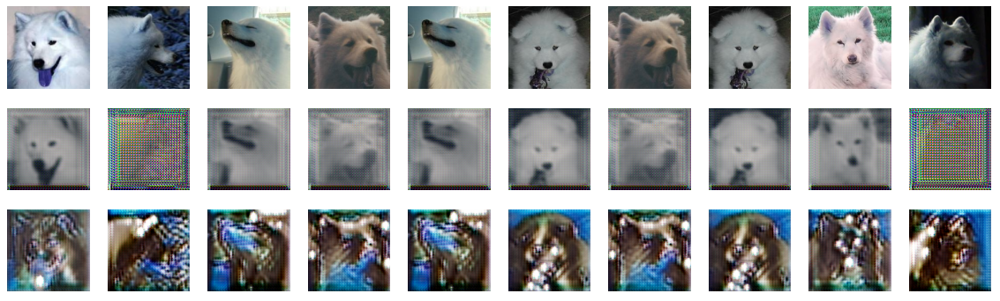

====== B as input


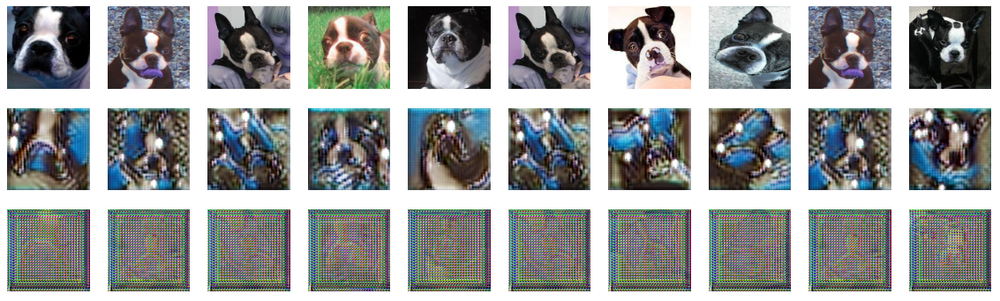

============= test set ================
====== A as input


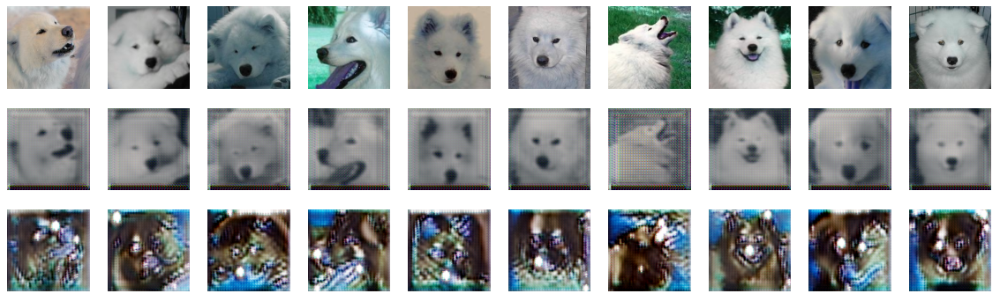

====== B as input


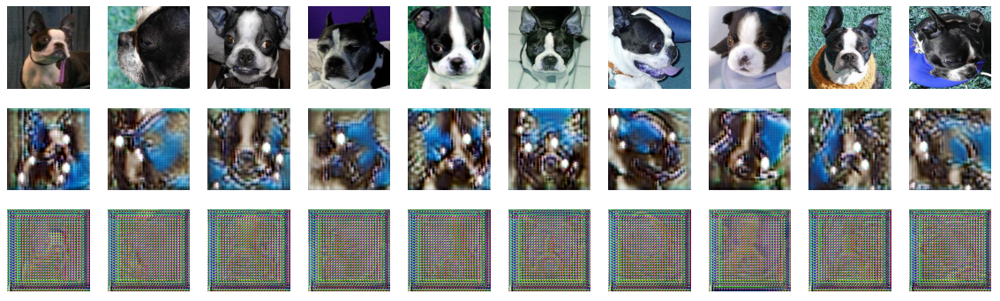

saved generator weights
saved discriminator weights
==== epoch 41
discriminator loss: B_on_real: 0.0392, B_on_fake: 0.0254, A_on_real: 0.0130, A_on_fake: 0.0136
generator A2B loss: total: 7.3169, adversarial: 0.7379, identity: 0.3012, forward: 0.1986, backward: 0.1340
generator B2A loss: total: 9.2211, adversarial: 1.1340, identity: 0.2337, forward: 0.1343, backward: 0.1974
==== epoch 42
discriminator loss: B_on_real: 0.0705, B_on_fake: 0.0407, A_on_real: 0.0122, A_on_fake: 0.0089
generator A2B loss: total: 7.6915, adversarial: 0.8424, identity: 0.2328, forward: 0.1939, backward: 0.1308
generator B2A loss: total: 9.4048, adversarial: 1.1765, identity: 0.2265, forward: 0.1325, backward: 0.1970
==== epoch 43
discriminator loss: B_on_real: 0.1034, B_on_fake: 0.0592, A_on_real: 0.0025, A_on_fake: 0.0011
generator A2B loss: total: 7.6311, adversarial: 0.8120, identity: 0.1942, forward: 0.2029, backward: 0.1348
generator B2A loss: total: 8.7095, adversarial: 1.0358, identity: 0.2424, forward

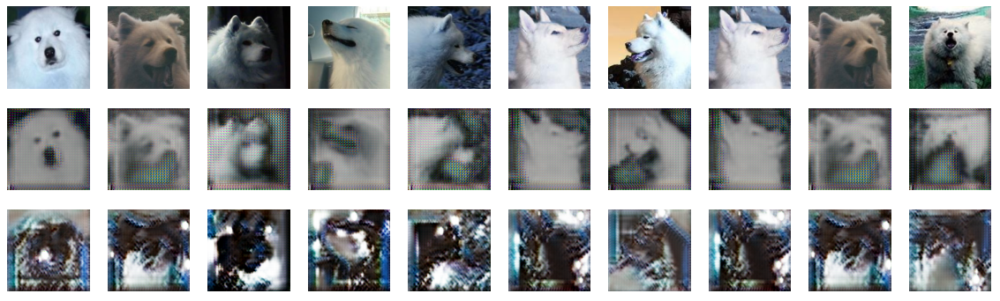

====== B as input


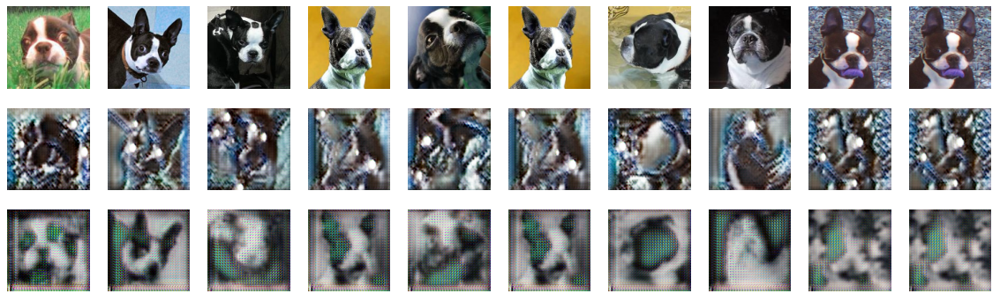

============= test set ================
====== A as input


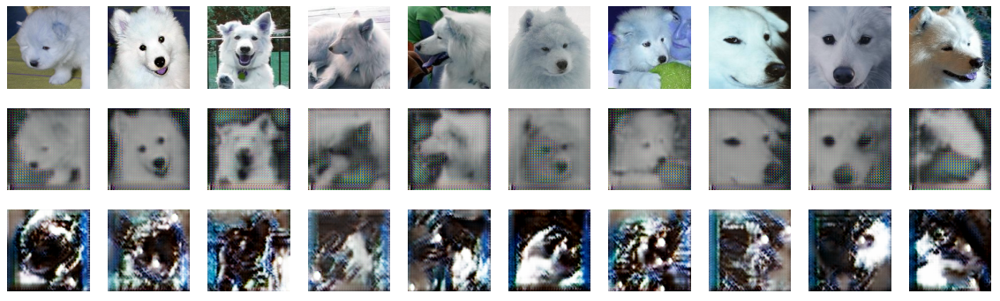

====== B as input


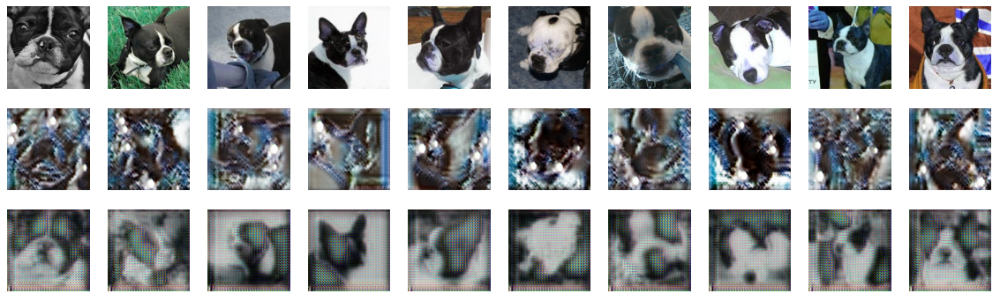

saved generator weights
saved discriminator weights
==== epoch 51
discriminator loss: B_on_real: 0.0278, B_on_fake: 0.0137, A_on_real: 0.0019, A_on_fake: 0.0038
generator A2B loss: total: 9.6999, adversarial: 1.1329, identity: 0.2093, forward: 0.2248, backward: 0.1578
generator B2A loss: total: 8.8687, adversarial: 0.9534, identity: 0.2979, forward: 0.1623, backward: 0.2181
==== epoch 52
discriminator loss: B_on_real: 0.0290, B_on_fake: 0.0298, A_on_real: 0.0018, A_on_fake: 0.0086
generator A2B loss: total: 8.0299, adversarial: 0.7896, identity: 0.2766, forward: 0.2309, backward: 0.1496
generator B2A loss: total: 8.1568, adversarial: 0.8001, identity: 0.3824, forward: 0.1493, backward: 0.2281
==== epoch 53
discriminator loss: B_on_real: 0.0726, B_on_fake: 0.0475, A_on_real: 0.0197, A_on_fake: 0.0092
generator A2B loss: total: 8.5403, adversarial: 0.9496, identity: 0.2333, forward: 0.2063, backward: 0.1495
generator B2A loss: total: 9.0697, adversarial: 1.0136, identity: 0.4043, forward

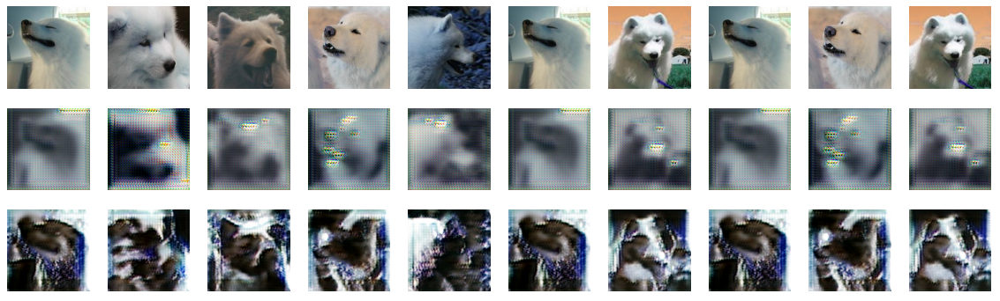

====== B as input


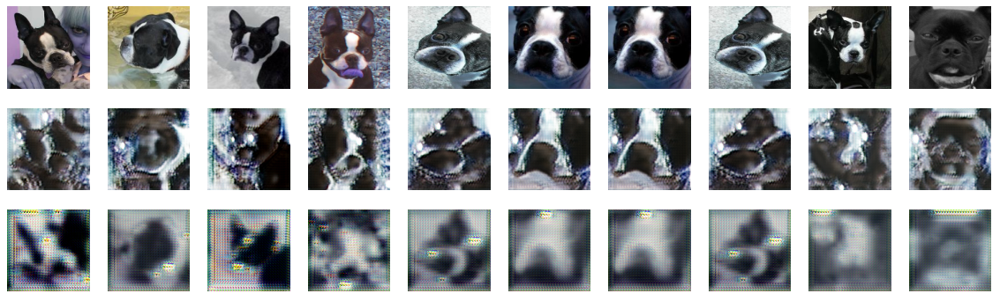

============= test set ================
====== A as input


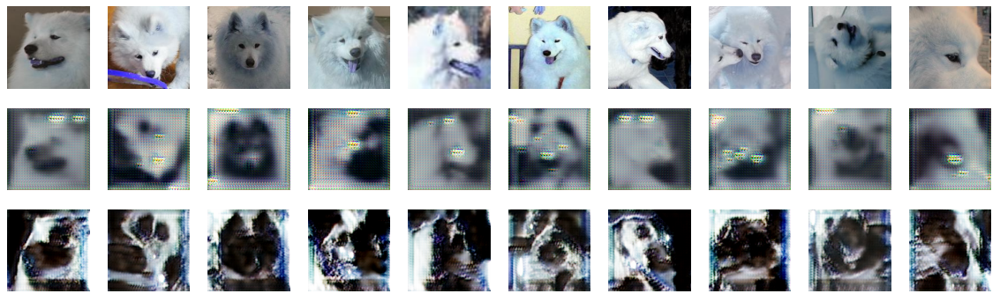

====== B as input


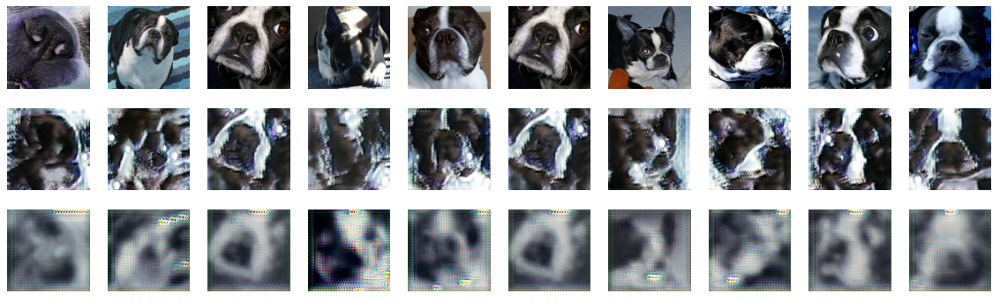

saved generator weights
saved discriminator weights
==== epoch 61
discriminator loss: B_on_real: 0.0148, B_on_fake: 0.0168, A_on_real: 0.0013, A_on_fake: 0.0030
generator A2B loss: total: 6.5433, adversarial: 0.6516, identity: 0.1901, forward: 0.1766, backward: 0.1330
generator B2A loss: total: 8.2897, adversarial: 0.9848, identity: 0.2989, forward: 0.1339, backward: 0.1727
==== epoch 62
discriminator loss: B_on_real: 0.0254, B_on_fake: 0.0155, A_on_real: 0.1403, A_on_fake: 0.4553
generator A2B loss: total: 9.0898, adversarial: 1.1067, identity: 0.2953, forward: 0.1828, backward: 0.1433
generator B2A loss: total: 7.3643, adversarial: 0.7725, identity: 0.2836, forward: 0.1422, backward: 0.1797
==== epoch 63
discriminator loss: B_on_real: 0.0513, B_on_fake: 0.0197, A_on_real: 0.1124, A_on_fake: 0.0465
generator A2B loss: total: 11.0563, adversarial: 1.5063, identity: 0.2735, forward: 0.1711, backward: 0.1541
generator B2A loss: total: 8.4207, adversarial: 0.9869, identity: 0.2684, forwar

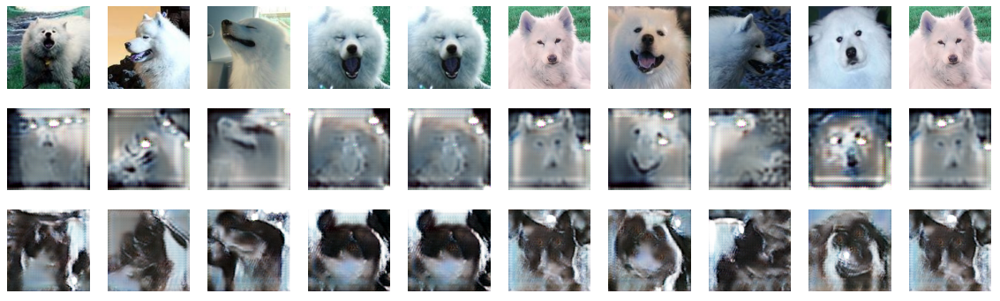

====== B as input


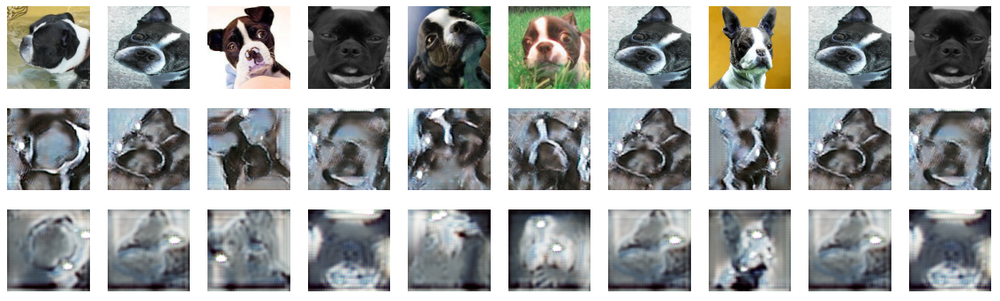

============= test set ================
====== A as input


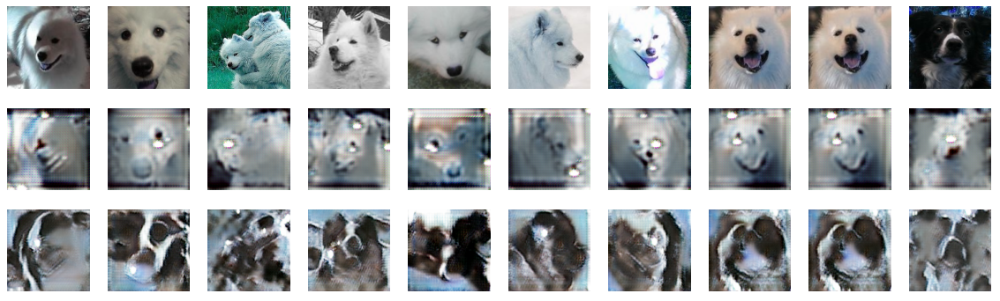

====== B as input


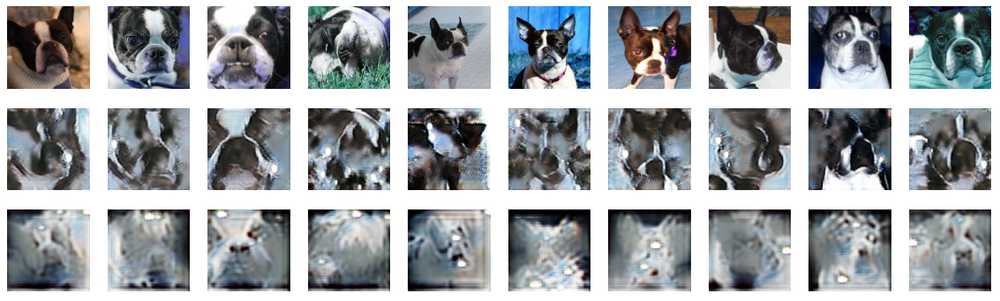

saved generator weights
saved discriminator weights
==== epoch 71
discriminator loss: B_on_real: 0.0088, B_on_fake: 0.0156, A_on_real: 0.0872, A_on_fake: 0.0662
generator A2B loss: total: 7.3477, adversarial: 0.8161, identity: 0.1946, forward: 0.1574, backward: 0.1499
generator B2A loss: total: 6.7143, adversarial: 0.7000, identity: 0.1943, forward: 0.1493, backward: 0.1527
==== epoch 72
discriminator loss: B_on_real: 0.0199, B_on_fake: 0.0131, A_on_real: 0.0388, A_on_fake: 0.0522
generator A2B loss: total: 8.1070, adversarial: 0.9661, identity: 0.2193, forward: 0.1493, backward: 0.1564
generator B2A loss: total: 6.0196, adversarial: 0.5548, identity: 0.1928, forward: 0.1564, backward: 0.1489
==== epoch 73
discriminator loss: B_on_real: 0.0162, B_on_fake: 0.0099, A_on_real: 0.0294, A_on_fake: 0.0139
generator A2B loss: total: 9.6103, adversarial: 1.2732, identity: 0.2148, forward: 0.1478, backward: 0.1551
generator B2A loss: total: 7.6995, adversarial: 0.8971, identity: 0.2003, forward

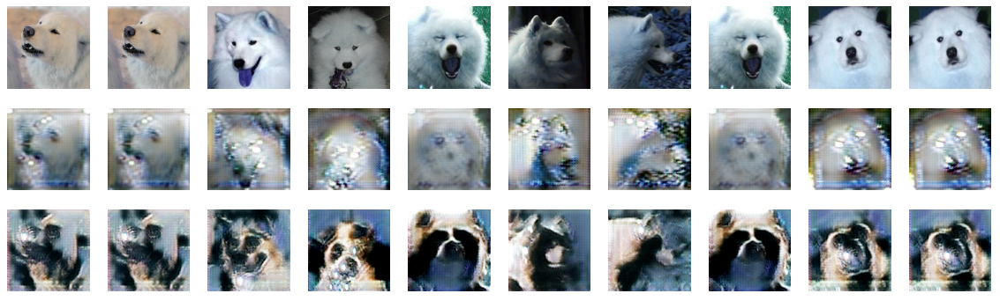

====== B as input


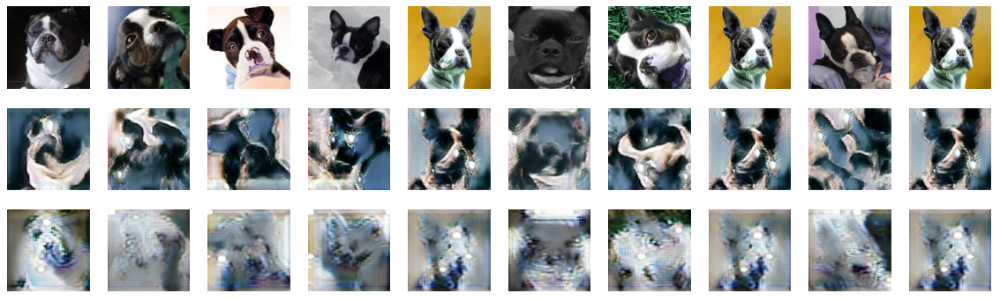

============= test set ================
====== A as input


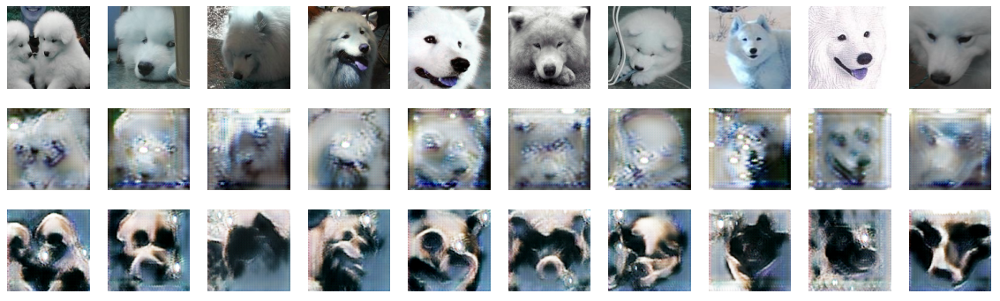

====== B as input


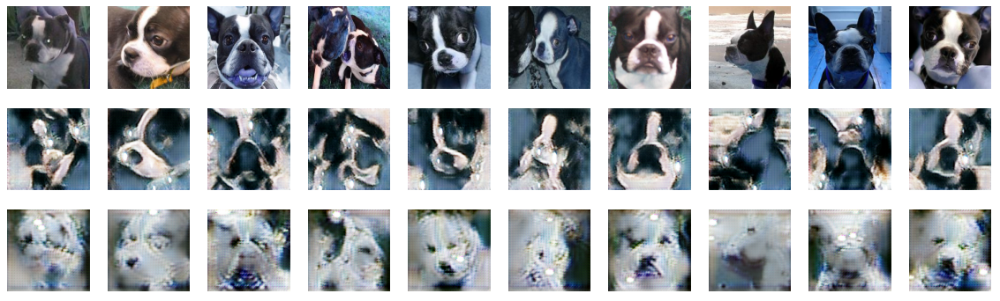

saved generator weights
saved discriminator weights
==== epoch 81
discriminator loss: B_on_real: 0.0150, B_on_fake: 0.0077, A_on_real: 0.0216, A_on_fake: 0.0310
generator A2B loss: total: 8.5402, adversarial: 1.0782, identity: 0.1943, forward: 0.1437, backward: 0.1518
generator B2A loss: total: 6.3504, adversarial: 0.6507, identity: 0.2000, forward: 0.1521, backward: 0.1377
==== epoch 82
discriminator loss: B_on_real: 0.0324, B_on_fake: 0.0164, A_on_real: 0.0651, A_on_fake: 0.0178
generator A2B loss: total: 6.6297, adversarial: 0.6743, identity: 0.2456, forward: 0.1484, backward: 0.1528
generator B2A loss: total: 8.5768, adversarial: 1.0843, identity: 0.1873, forward: 0.1513, backward: 0.1455
==== epoch 83
discriminator loss: B_on_real: 0.0087, B_on_fake: 0.0154, A_on_real: 0.0576, A_on_fake: 0.0313
generator A2B loss: total: 7.5582, adversarial: 0.8763, identity: 0.1850, forward: 0.1487, backward: 0.1505
generator B2A loss: total: 9.0495, adversarial: 1.1813, identity: 0.1896, forward

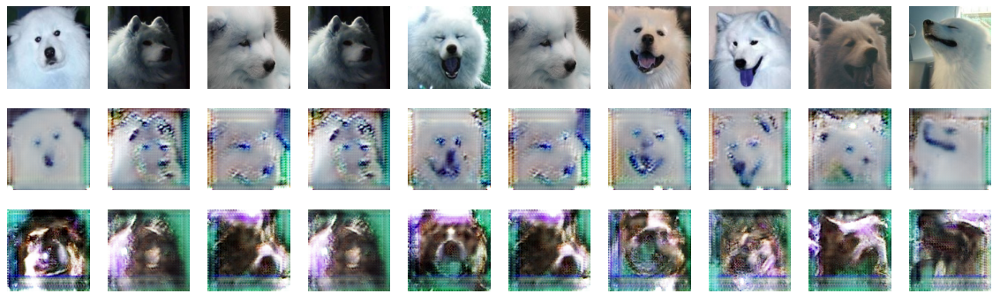

====== B as input


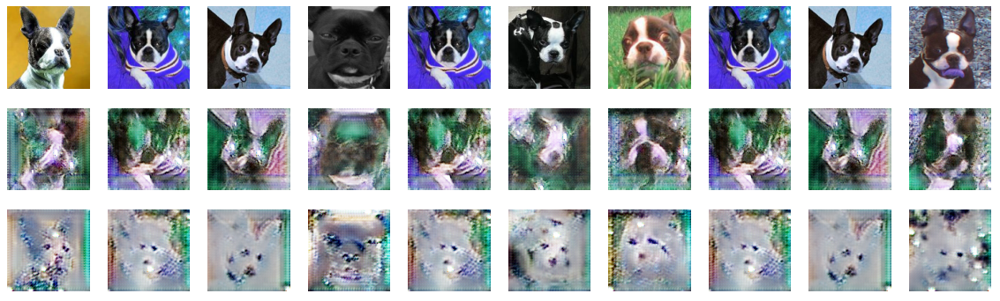

============= test set ================
====== A as input


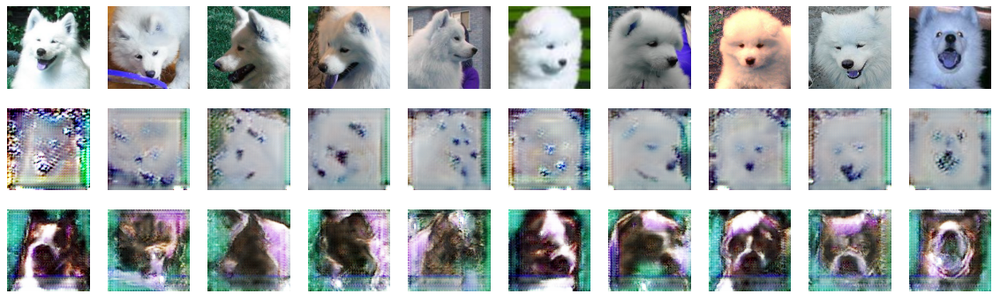

====== B as input


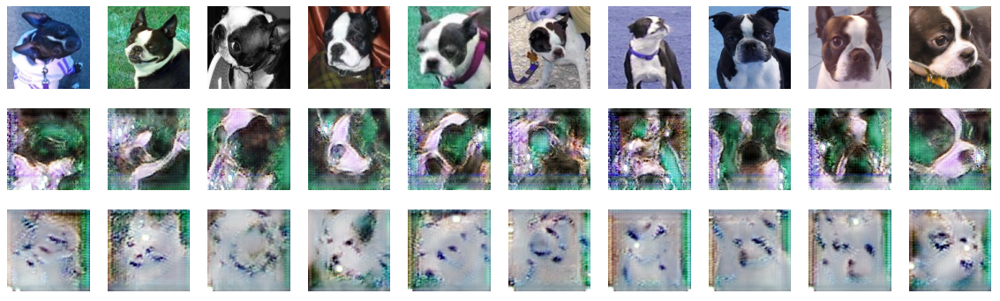

saved generator weights
saved discriminator weights
==== epoch 91
discriminator loss: B_on_real: 0.0138, B_on_fake: 0.0326, A_on_real: 0.0257, A_on_fake: 0.0275
generator A2B loss: total: 7.4056, adversarial: 0.9041, identity: 0.1895, forward: 0.1284, backward: 0.1412
generator B2A loss: total: 6.3863, adversarial: 0.7128, identity: 0.1782, forward: 0.1406, backward: 0.1238
==== epoch 92
discriminator loss: B_on_real: 0.0414, B_on_fake: 0.0199, A_on_real: 0.0305, A_on_fake: 0.0214
generator A2B loss: total: 8.4917, adversarial: 1.1146, identity: 0.2067, forward: 0.1265, backward: 0.1447
generator B2A loss: total: 7.2182, adversarial: 0.8671, identity: 0.1987, forward: 0.1439, backward: 0.1246
==== epoch 93
discriminator loss: B_on_real: 0.0171, B_on_fake: 0.0116, A_on_real: 0.0546, A_on_fake: 0.0713
generator A2B loss: total: 8.9372, adversarial: 1.2094, identity: 0.1902, forward: 0.1265, backward: 0.1435
generator B2A loss: total: 7.5984, adversarial: 0.9437, identity: 0.1889, forward

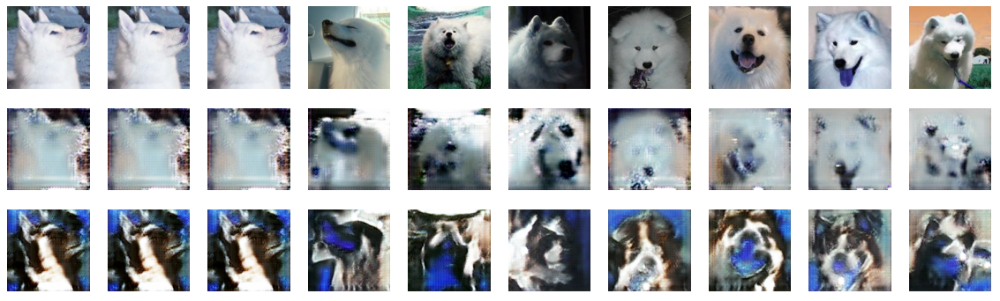

====== B as input


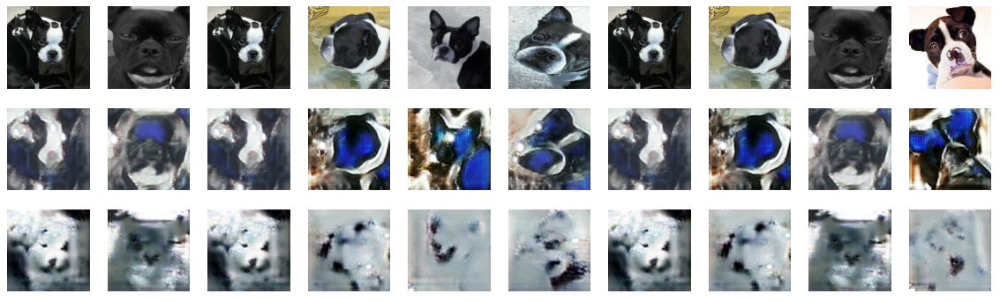

============= test set ================
====== A as input


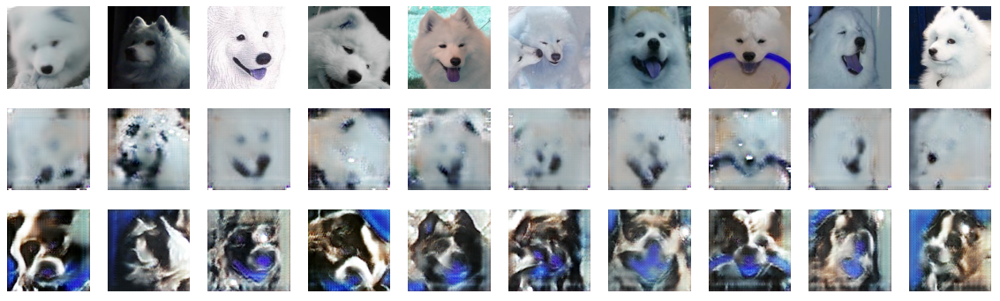

====== B as input


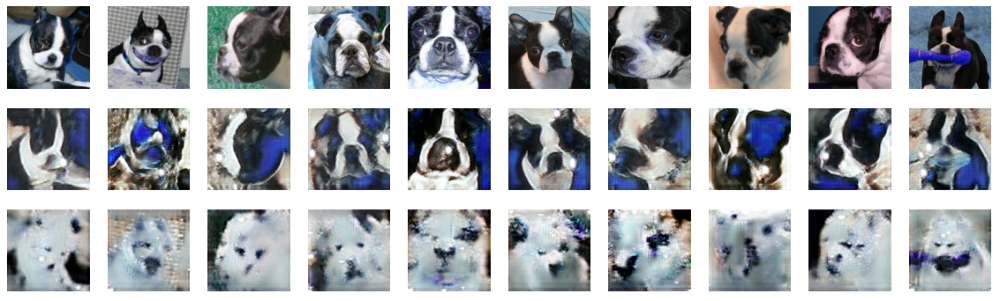

saved generator weights
saved discriminator weights
==== epoch 101
discriminator loss: B_on_real: 0.0055, B_on_fake: 0.0135, A_on_real: 0.0363, A_on_fake: 0.0264
generator A2B loss: total: 7.1554, adversarial: 0.8521, identity: 0.2176, forward: 0.1260, backward: 0.1417
generator B2A loss: total: 7.4030, adversarial: 0.9136, identity: 0.1973, forward: 0.1413, backward: 0.1224
==== epoch 102
discriminator loss: B_on_real: 0.0162, B_on_fake: 0.0136, A_on_real: 0.0264, A_on_fake: 0.0204
generator A2B loss: total: 7.8068, adversarial: 0.9772, identity: 0.2097, forward: 0.1280, backward: 0.1431
generator B2A loss: total: 8.2285, adversarial: 1.0777, identity: 0.1960, forward: 0.1414, backward: 0.1230
==== epoch 103
discriminator loss: B_on_real: 0.0097, B_on_fake: 0.0074, A_on_real: 0.0149, A_on_fake: 0.0246
generator A2B loss: total: 8.5671, adversarial: 1.1233, identity: 0.1916, forward: 0.1290, backward: 0.1469
generator B2A loss: total: 6.6166, adversarial: 0.7272, identity: 0.1863, forw

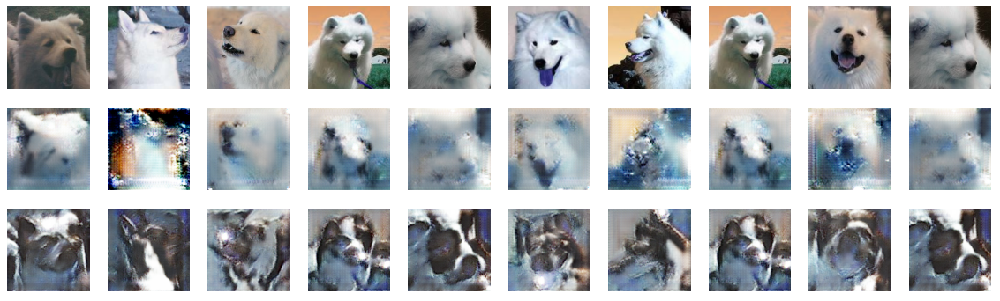

====== B as input


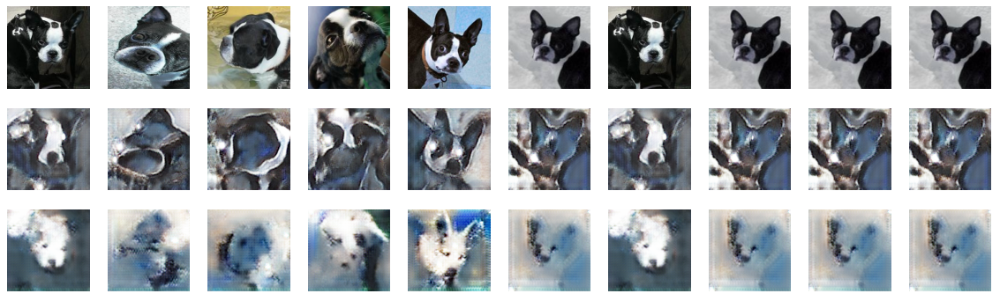

============= test set ================
====== A as input


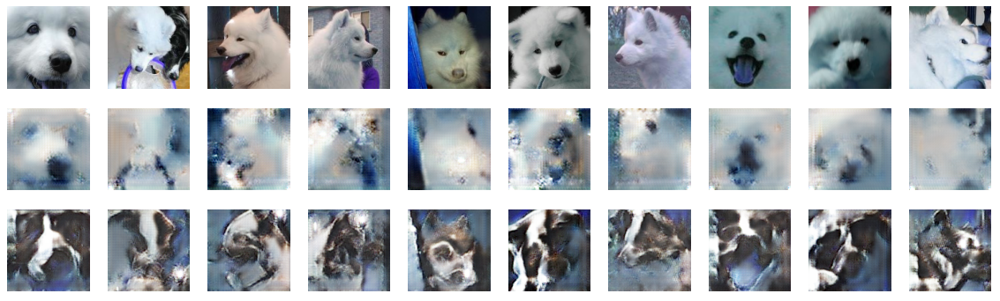

====== B as input


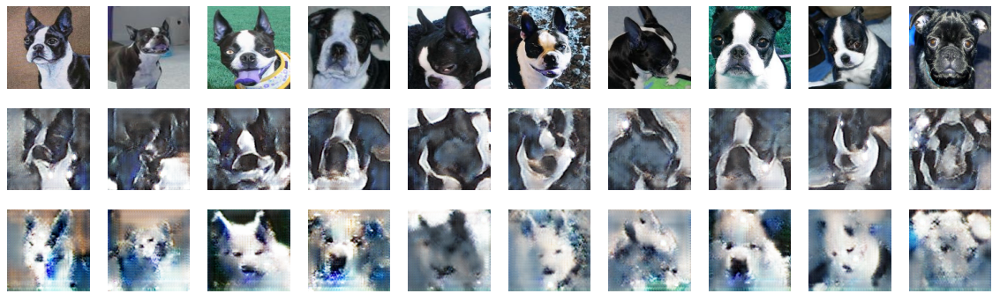

saved generator weights
saved discriminator weights
==== epoch 111
discriminator loss: B_on_real: 0.0045, B_on_fake: 0.0149, A_on_real: 0.0395, A_on_fake: 0.0362
generator A2B loss: total: 6.8269, adversarial: 0.8031, identity: 0.1835, forward: 0.1278, backward: 0.1350
generator B2A loss: total: 7.5541, adversarial: 0.9436, identity: 0.1892, forward: 0.1372, backward: 0.1275
==== epoch 112
discriminator loss: B_on_real: 0.0102, B_on_fake: 0.0073, A_on_real: 0.0170, A_on_fake: 0.0364
generator A2B loss: total: 8.9283, adversarial: 1.2199, identity: 0.1949, forward: 0.1244, backward: 0.1390
generator B2A loss: total: 6.5783, adversarial: 0.7626, identity: 0.1858, forward: 0.1380, backward: 0.1199
==== epoch 113
discriminator loss: B_on_real: 0.0052, B_on_fake: 0.0079, A_on_real: 0.0952, A_on_fake: 0.1326
generator A2B loss: total: 7.8953, adversarial: 0.9829, identity: 0.2536, forward: 0.1338, backward: 0.1390
generator B2A loss: total: 6.0752, adversarial: 0.6253, identity: 0.1867, forw

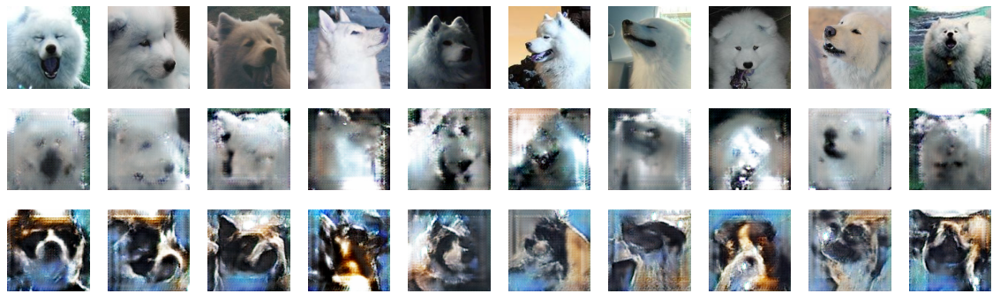

====== B as input


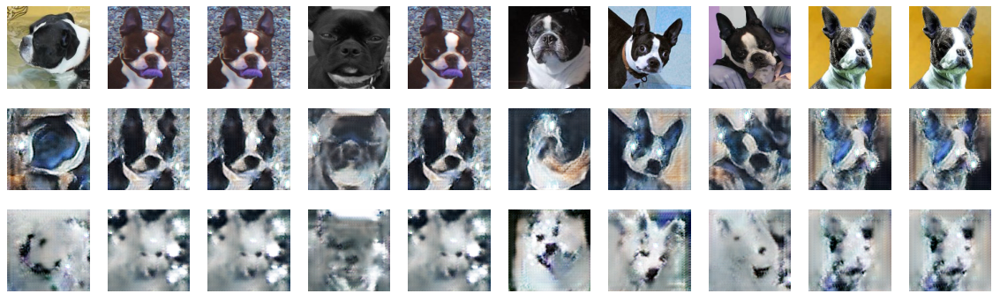

============= test set ================
====== A as input


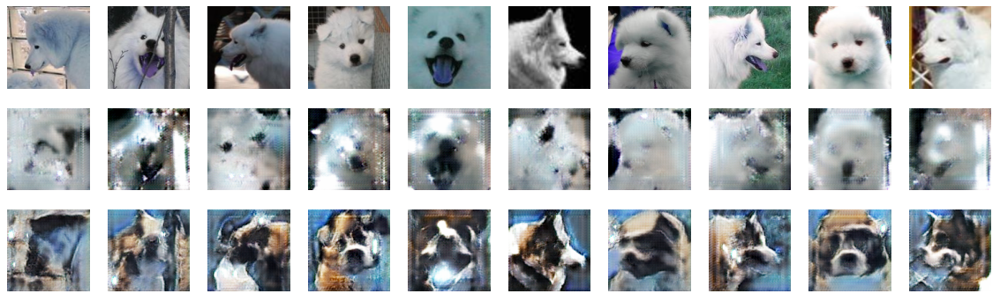

====== B as input


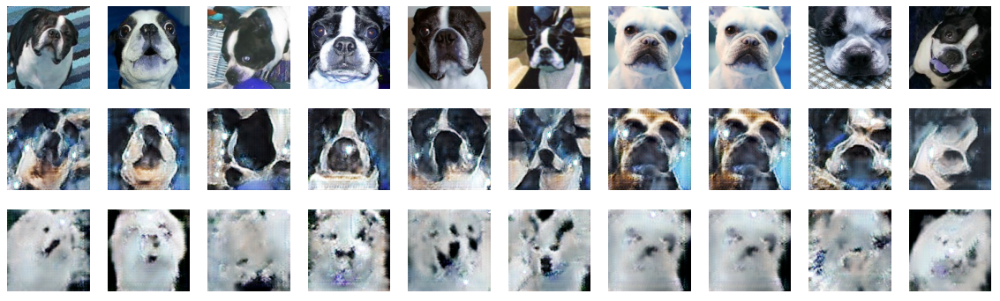

saved generator weights
saved discriminator weights
==== epoch 121
discriminator loss: B_on_real: 0.0137, B_on_fake: 0.0066, A_on_real: 0.0104, A_on_fake: 0.0227
generator A2B loss: total: 8.1407, adversarial: 1.0655, identity: 0.1765, forward: 0.1267, backward: 0.1369
generator B2A loss: total: 7.2922, adversarial: 0.9102, identity: 0.1845, forward: 0.1361, backward: 0.1195
==== epoch 122
discriminator loss: B_on_real: 0.0191, B_on_fake: 0.0103, A_on_real: 0.0976, A_on_fake: 0.0910
generator A2B loss: total: 7.9088, adversarial: 1.0384, identity: 0.1840, forward: 0.1215, backward: 0.1318
generator B2A loss: total: 5.9551, adversarial: 0.6597, identity: 0.1709, forward: 0.1320, backward: 0.1165
==== epoch 123
discriminator loss: B_on_real: 0.0103, B_on_fake: 0.0090, A_on_real: 0.0136, A_on_fake: 0.0498
generator A2B loss: total: 7.4584, adversarial: 0.9246, identity: 0.1855, forward: 0.1258, backward: 0.1393
generator B2A loss: total: 6.4252, adversarial: 0.7213, identity: 0.1714, forw

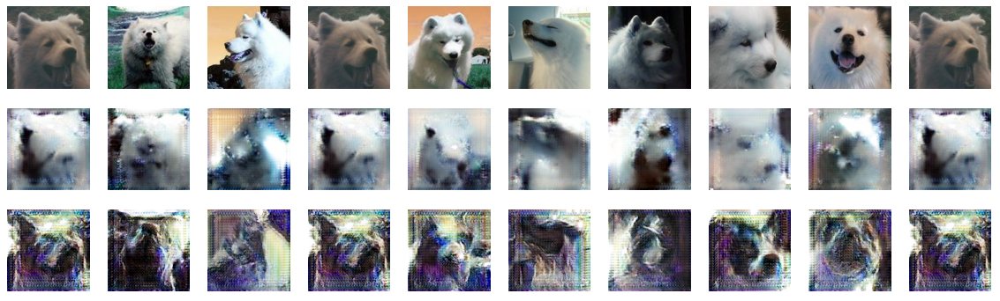

====== B as input


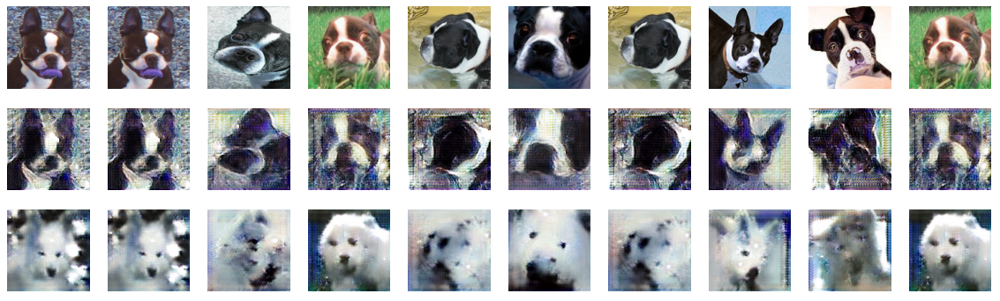

============= test set ================
====== A as input


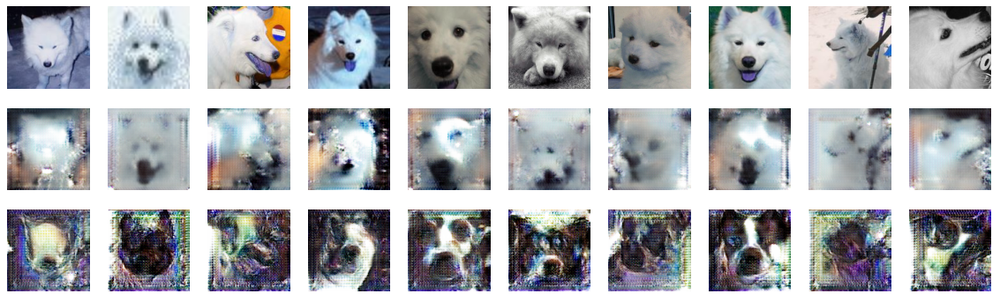

====== B as input


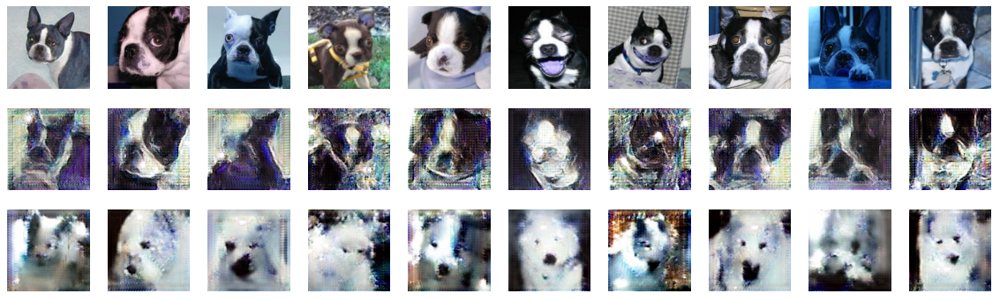

saved generator weights
saved discriminator weights
==== epoch 131
discriminator loss: B_on_real: 0.0070, B_on_fake: 0.0025, A_on_real: 0.0143, A_on_fake: 0.0182
generator A2B loss: total: 7.7161, adversarial: 0.9873, identity: 0.2096, forward: 0.1193, backward: 0.1377
generator B2A loss: total: 8.2242, adversarial: 1.0984, identity: 0.1813, forward: 0.1385, backward: 0.1166
==== epoch 132
discriminator loss: B_on_real: 0.0020, B_on_fake: 0.0052, A_on_real: 0.0177, A_on_fake: 0.0217
generator A2B loss: total: 7.5129, adversarial: 0.9605, identity: 0.1910, forward: 0.1148, backward: 0.1372
generator B2A loss: total: 7.9765, adversarial: 1.0572, identity: 0.1781, forward: 0.1366, backward: 0.1146
==== epoch 133
discriminator loss: B_on_real: 0.0043, B_on_fake: 0.0070, A_on_real: 0.0187, A_on_fake: 0.0283
generator A2B loss: total: 7.2800, adversarial: 0.9000, identity: 0.2046, forward: 0.1225, backward: 0.1350
generator B2A loss: total: 5.8882, adversarial: 0.6339, identity: 0.1861, forw

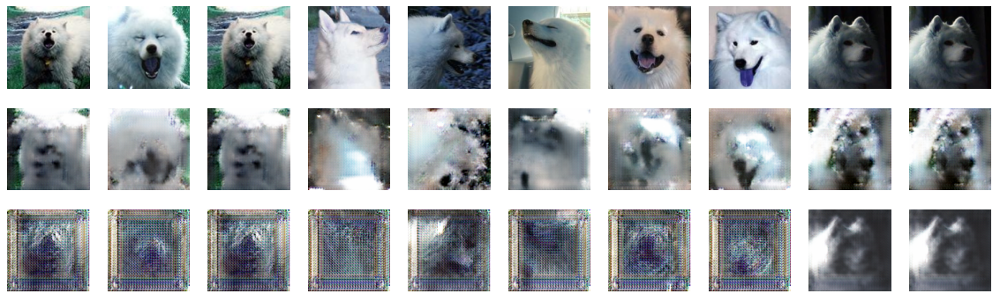

====== B as input


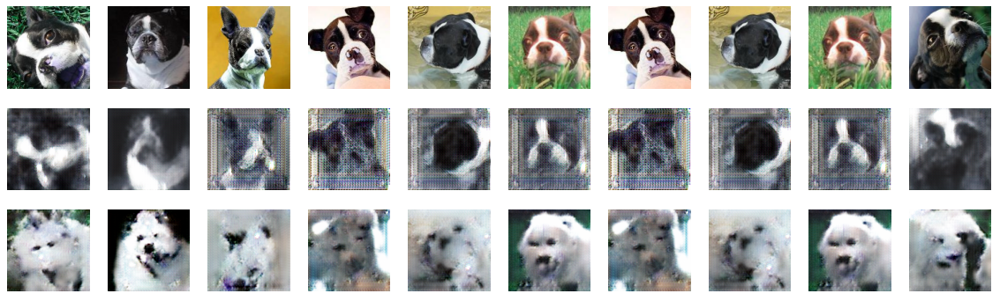

============= test set ================
====== A as input


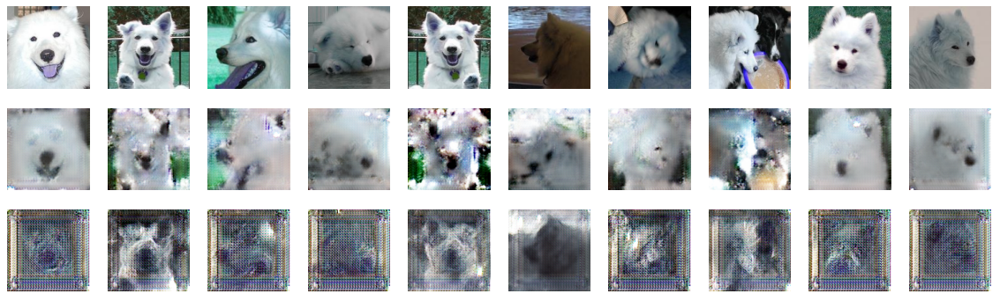

====== B as input


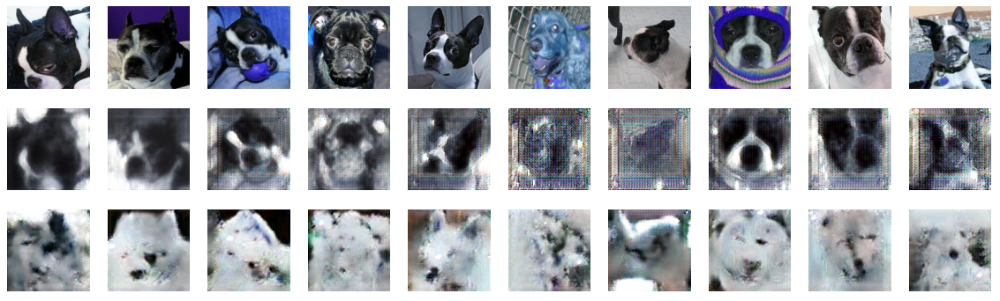

saved generator weights
saved discriminator weights
==== epoch 141
discriminator loss: B_on_real: 0.0058, B_on_fake: 0.0065, A_on_real: 0.0246, A_on_fake: 0.0161
generator A2B loss: total: 7.4363, adversarial: 0.9845, identity: 0.1594, forward: 0.1074, backward: 0.1280
generator B2A loss: total: 6.8721, adversarial: 0.8740, identity: 0.1699, forward: 0.1275, backward: 0.1058
==== epoch 142
discriminator loss: B_on_real: 0.0045, B_on_fake: 0.0075, A_on_real: 0.0281, A_on_fake: 0.0417
generator A2B loss: total: 7.4227, adversarial: 0.9755, identity: 0.1575, forward: 0.1108, backward: 0.1280
generator B2A loss: total: 7.2039, adversarial: 0.9346, identity: 0.1697, forward: 0.1281, backward: 0.1080
==== epoch 143
discriminator loss: B_on_real: 0.0027, B_on_fake: 0.0037, A_on_real: 0.0379, A_on_fake: 0.0187
generator A2B loss: total: 7.3471, adversarial: 0.9640, identity: 0.1587, forward: 0.1086, backward: 0.1282
generator B2A loss: total: 6.3460, adversarial: 0.7650, identity: 0.1788, forw

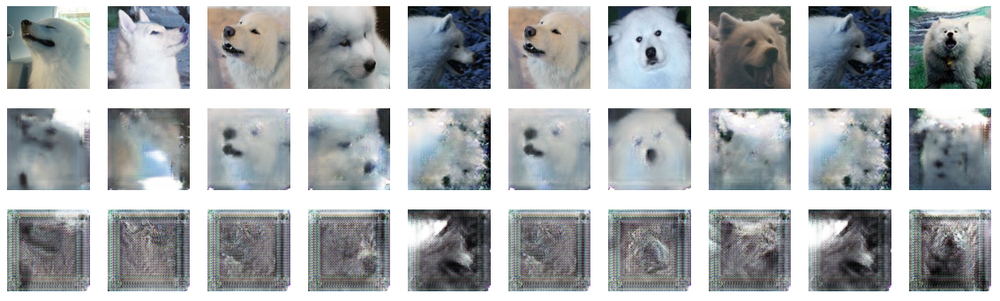

====== B as input


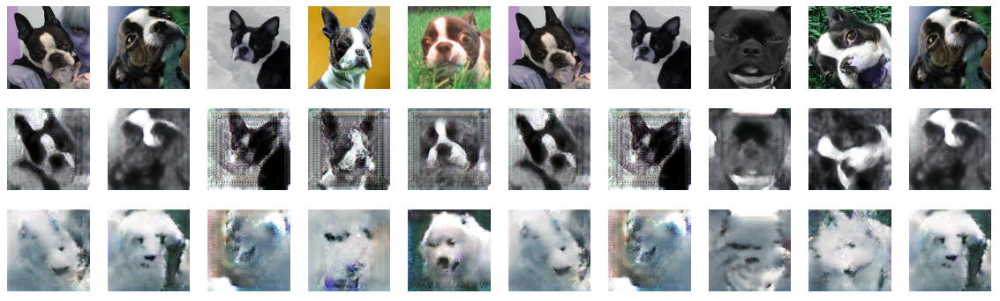

============= test set ================
====== A as input


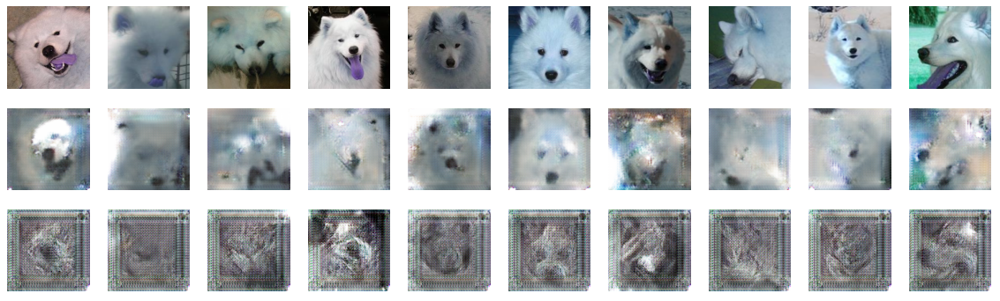

====== B as input


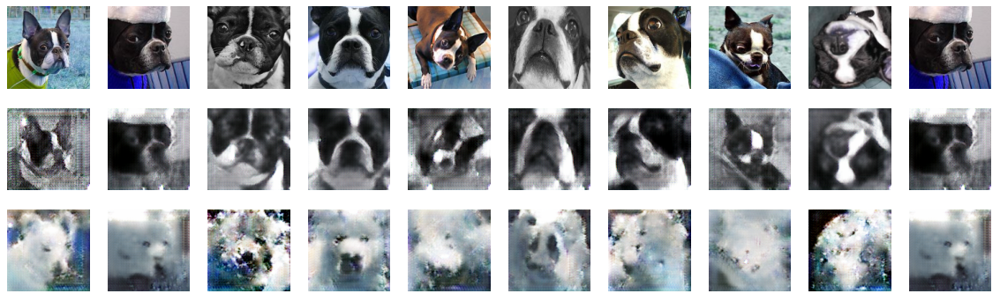

saved generator weights
saved discriminator weights
==== epoch 151
discriminator loss: B_on_real: 0.0011, B_on_fake: 0.0026, A_on_real: 0.0125, A_on_fake: 0.0231
generator A2B loss: total: 7.2727, adversarial: 0.9694, identity: 0.1423, forward: 0.1057, backward: 0.1226
generator B2A loss: total: 4.9856, adversarial: 0.5128, identity: 0.1716, forward: 0.1218, backward: 0.1032
==== epoch 152
discriminator loss: B_on_real: 0.0009, B_on_fake: 0.0024, A_on_real: 0.0171, A_on_fake: 0.0215
generator A2B loss: total: 7.3168, adversarial: 0.9896, identity: 0.1435, forward: 0.1026, backward: 0.1199
generator B2A loss: total: 5.2716, adversarial: 0.5786, identity: 0.1727, forward: 0.1206, backward: 0.1000
==== epoch 153
discriminator loss: B_on_real: 0.0013, B_on_fake: 0.0034, A_on_real: 0.0209, A_on_fake: 0.0160
generator A2B loss: total: 7.2730, adversarial: 0.9779, identity: 0.1492, forward: 0.1021, backward: 0.1214
generator B2A loss: total: 7.1368, adversarial: 0.9340, identity: 0.1681, forw

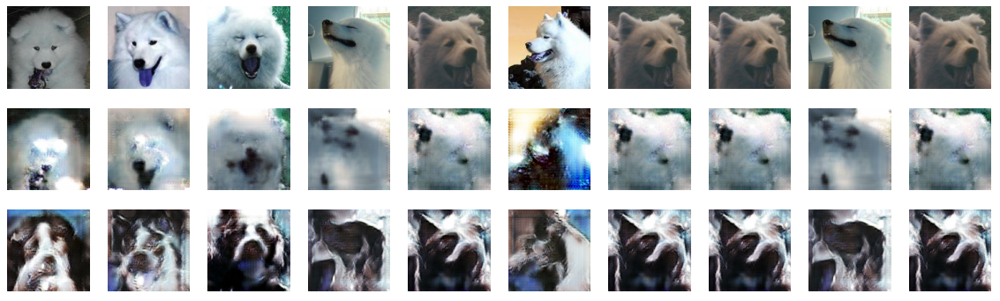

====== B as input


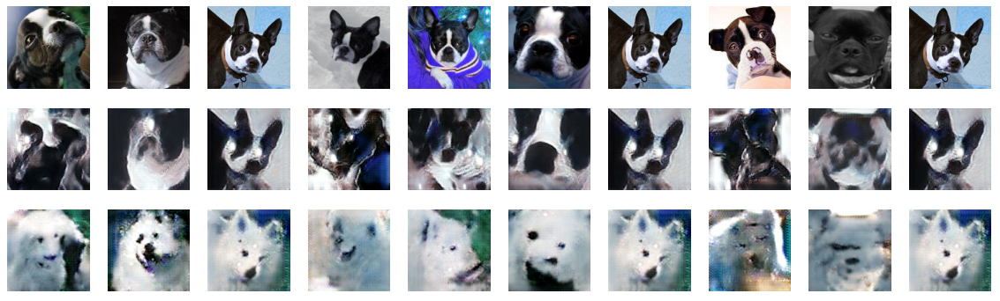

============= test set ================
====== A as input


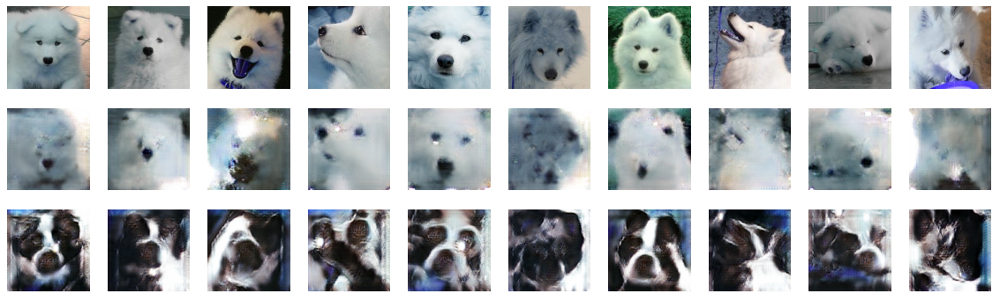

====== B as input


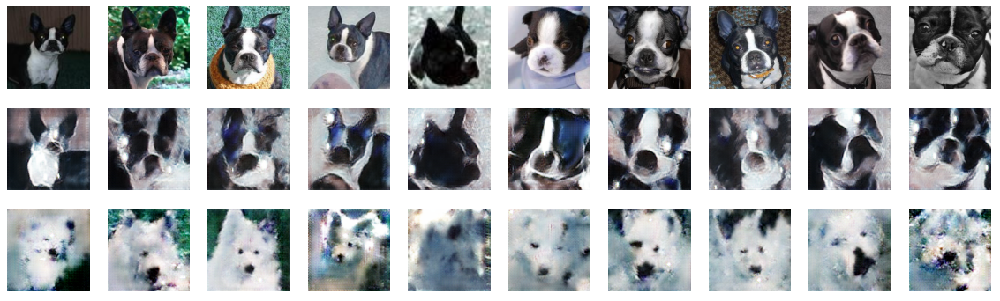

saved generator weights
saved discriminator weights
==== epoch 161
discriminator loss: B_on_real: 0.0042, B_on_fake: 0.0095, A_on_real: 0.0211, A_on_fake: 0.0281
generator A2B loss: total: 6.8019, adversarial: 0.8489, identity: 0.1749, forward: 0.1157, backward: 0.1226
generator B2A loss: total: 6.8686, adversarial: 0.8700, identity: 0.1651, forward: 0.1219, backward: 0.1135
==== epoch 162
discriminator loss: B_on_real: 0.0103, B_on_fake: 0.0270, A_on_real: 0.0120, A_on_fake: 0.0081
generator A2B loss: total: 6.4241, adversarial: 0.7082, identity: 0.1984, forward: 0.1222, backward: 0.1463
generator B2A loss: total: 7.3104, adversarial: 0.9053, identity: 0.1630, forward: 0.1400, backward: 0.1221
==== epoch 163
discriminator loss: B_on_real: 0.0041, B_on_fake: 0.0041, A_on_real: 0.0034, A_on_fake: 0.0099
generator A2B loss: total: 7.7856, adversarial: 1.0116, identity: 0.1996, forward: 0.1251, backward: 0.1277
generator B2A loss: total: 7.2073, adversarial: 0.9100, identity: 0.1643, forw

KeyboardInterrupt: 

In [64]:
epochs = 10000000
batch_size = 16
n_batch = 16
ai = math.ceil(len(train_data_A) / batch_size)
bi = math.ceil(len(train_data_B) / batch_size)
ii = min(ai, bi)

output_dir = Path(model_dir)
output_dir.mkdir(parents=True, exist_ok=True)

my_model.load_weights()

poolA, poolB = list(), list()

for epoch in range(epochs):
        
    n_patch = d_A.output_shape[1]
    
    for i in range(ii-1):
        
        # select a batch of real samples
        X_realA, y_realA = generate_real_samples(train_data_A[batch_size*i:batch_size*(i+1)], n_batch, n_patch)
        X_realB, y_realB = generate_real_samples(train_data_B[batch_size*i:batch_size*(i+1)], n_batch, n_patch)
        # generate a batch of fake samples
        X_fakeA, y_fakeA = generate_fake_samples(g_B2A, X_realB, n_patch)
        X_fakeB, y_fakeB = generate_fake_samples(g_A2B, X_realA, n_patch)
        # update fakes from pool
        X_fakeA_pool = update_image_pool(poolA, X_fakeA)
        X_fakeB_pool = update_image_pool(poolB, X_fakeB)

        # update generator A->B via adversarial and cycle loss
        total_A2B, a_A2B, identity_A2B, f_A2B, b_A2B = c_model_AtoB.train_on_batch([X_realA, X_realB], [y_realB, X_realB, X_realA, X_realB])

        # update discriminator for B -> [real/fake]
        dB_loss1 = d_B.train_on_batch(X_realB, y_realB)
        dB_loss2 = d_B.train_on_batch(X_fakeB_pool, y_fakeB)
        
        # update generator B->A via adversarial and cycle loss
        total_B2A, a_B2A, identity_B2A, f_B2A, b_B2A  = c_model_BtoA.train_on_batch([X_realB, X_realA], [y_realA, X_realA, X_realB, X_realA])

        # update discriminator for A -> [real/fake]
        dA_loss1 = d_A.train_on_batch(X_realA, y_realA)
        dA_loss2 = d_A.train_on_batch(X_fakeA_pool, y_fakeA)
        
        
    print('==== epoch {}'.format(epoch))
    print('discriminator loss: B_on_real: {:.4f}, B_on_fake: {:.4f}, A_on_real: {:.4f}, A_on_fake: {:.4f}'.format(dB_loss1, dB_loss2, dA_loss1, dA_loss2))
    print('generator A2B loss: total: {:.4f}, adversarial: {:.4f}, identity: {:.4f}, forward: {:.4f}, backward: {:.4f}'.format(total_A2B, a_A2B, identity_A2B, f_A2B, b_A2B))
    print('generator B2A loss: total: {:.4f}, adversarial: {:.4f}, identity: {:.4f}, forward: {:.4f}, backward: {:.4f}'.format(total_B2A, a_B2A, identity_B2A, f_B2A, b_B2A))
    
    if epoch % 10 == 0:
        print('============= train set ================')
        predictions_AA = g_B2A.predict(X_realA)
        print('====== A as input')
        display3(X_realA, predictions_AA, X_fakeB)
        
        predictions_BB = g_A2B.predict(X_realB)
        print('====== B as input')
        display3(X_realB, predictions_BB, X_fakeA)
        
        print('============= test set ================')
        predictions_AA = g_B2A.predict(test_data_A)
        predictions_AB = g_A2B.predict(test_data_A)
        print('====== A as input')
        display3(test_data_A, predictions_AA, predictions_AB)
        
        predictions_BB = g_A2B.predict(test_data_B)
        predictions_BA = g_B2A.predict(test_data_B)
        print('====== B as input')
        display3(test_data_B, predictions_BB, predictions_BA)
        
        my_model.save_weights()
        
    
    